In [2]:
# Imports

import matplotlib.pyplot as plt
import numpy as np
from phaseportrait import PhasePortrait2D, PhasePortrait3D

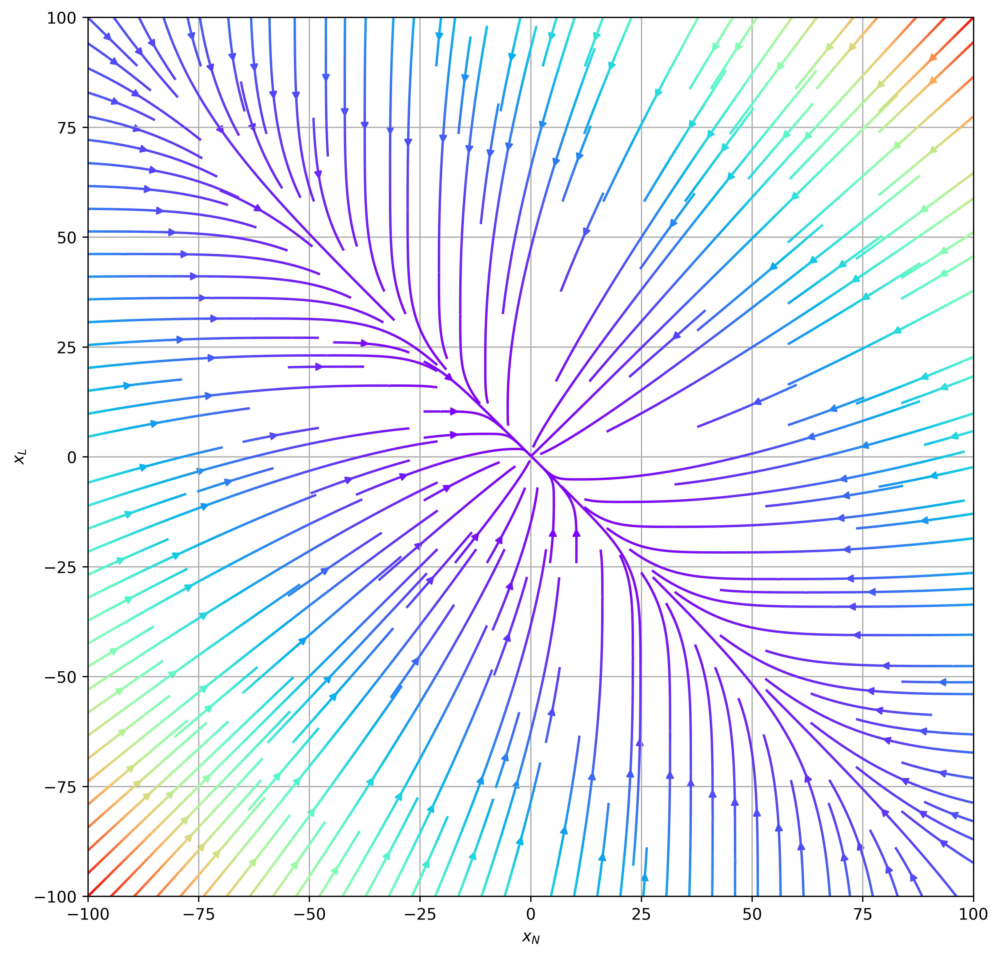

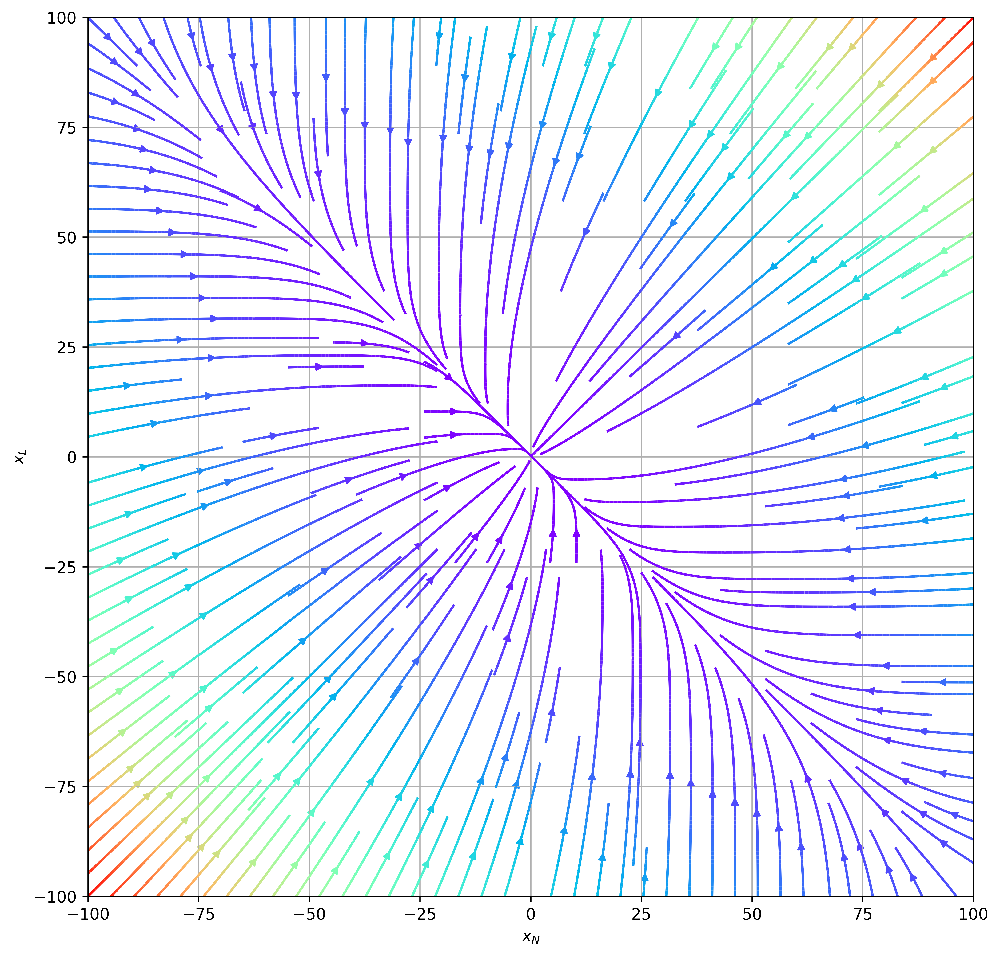

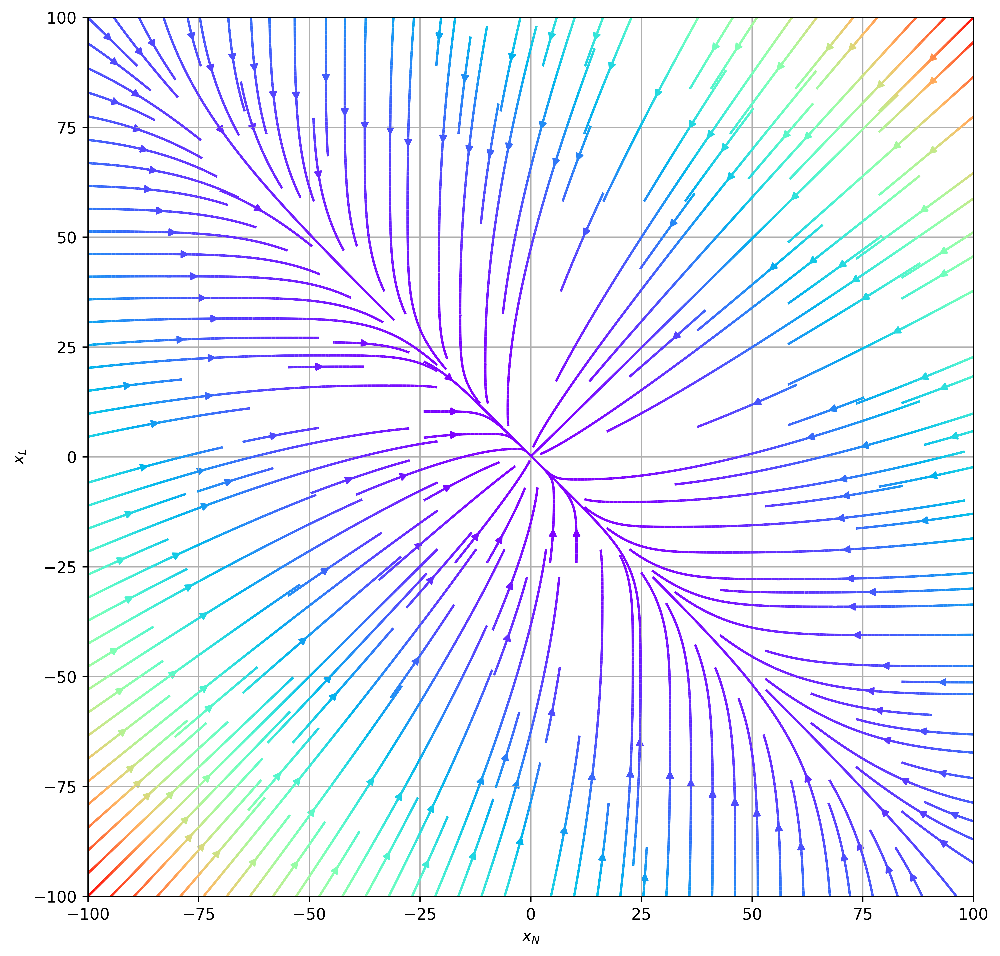

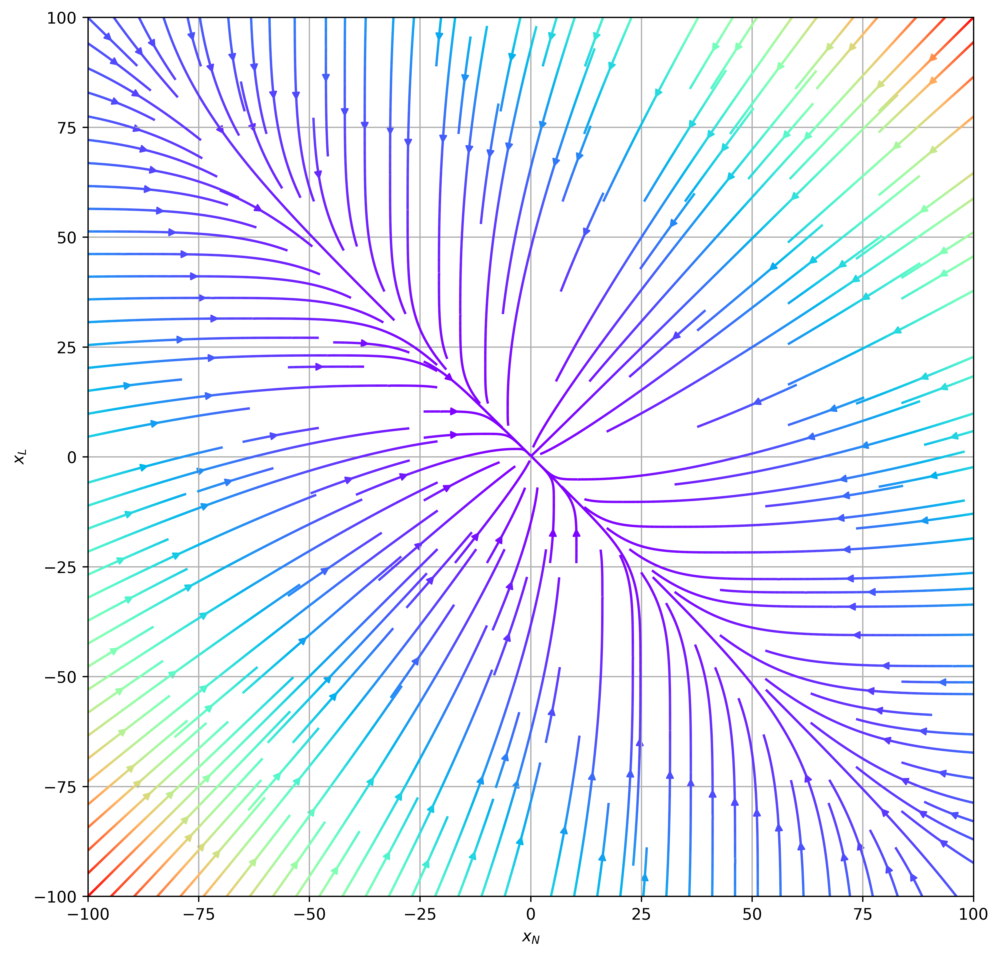

In [5]:
psis = [1e-3, 1e-2, 1e0, 1e1] 

alpha=1.5e-4
k = 2.1e4
T_E = 5.554
T_L = 3.018
T_N = 0.175
d = 1e-2
beta = 8e-4
S_star = 3
gamma = 0.5
x_T=0.5 

a_N =-(k*alpha*(T_N - T_E))/d
a_L = -(k*alpha*(T_L - T_E))/d
b = (k*beta*S_star)/d

for psi in psis:
    def three_box_final(x_N, x_L, psi=psi, a_N=a_N, a_L=a_L, b=b, gamma=gamma):

        dx_N = gamma*psi+(1-x_N)+abs(a_N+b*(2*x_N-x_T+x_L))*(x_T-x_L-2*x_N)
        dx_L = (1-gamma)*psi+(1-x_L)+abs(a_L+b*(2*x_L-x_T+x_N))*(x_T-x_N-2*x_L)
        
        return dx_N, dx_L

    plt.rcParams['figure.figsize'] = [10, 10]
    plt.rcParams['figure.dpi'] = 600

    three_box_reduced_portrait = PhasePortrait2D(three_box_final, [-100,100], MeshDim=40, Title=r'', xlabel=r"$x_N$", ylabel=r"$x_L$")
    fig, ax = three_box_reduced_portrait.plot()
    plt.show()
    # save figure
    # fig.savefig(f"gif1/kd_{kd}.png")

### Having a look at 3D system

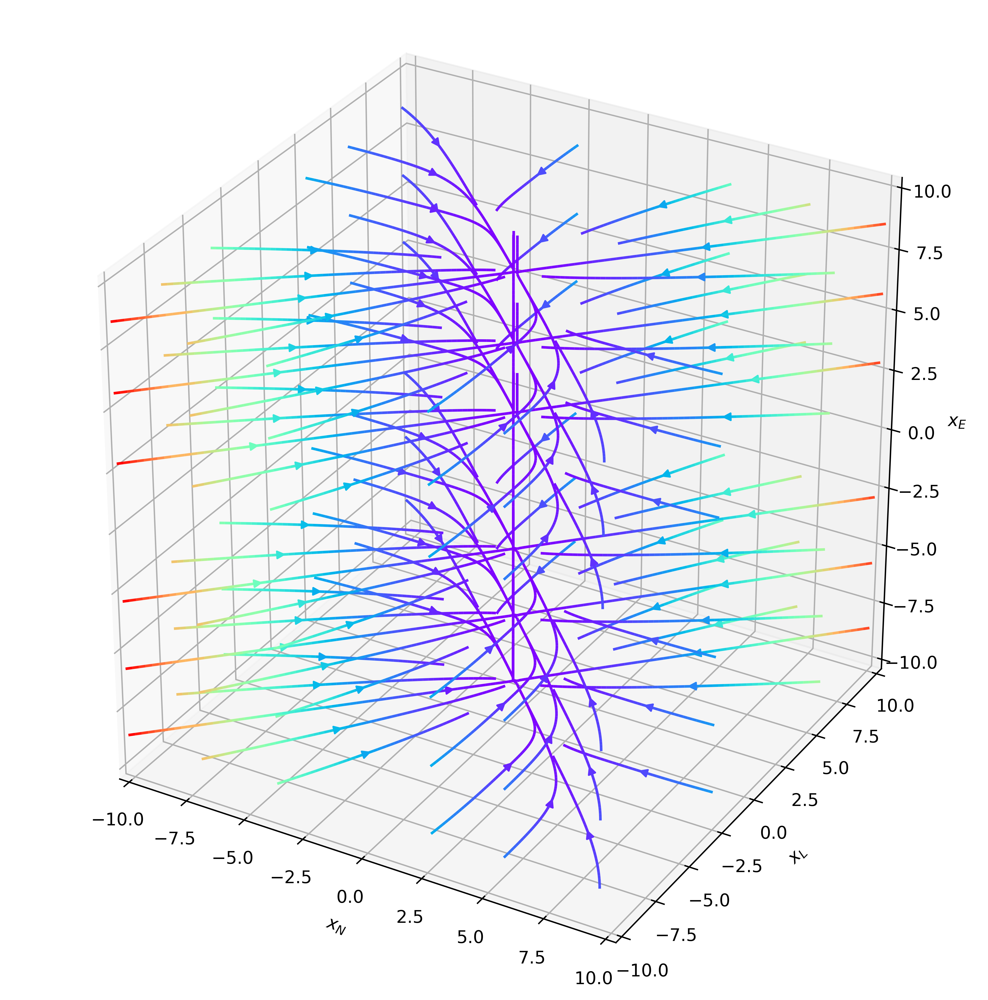

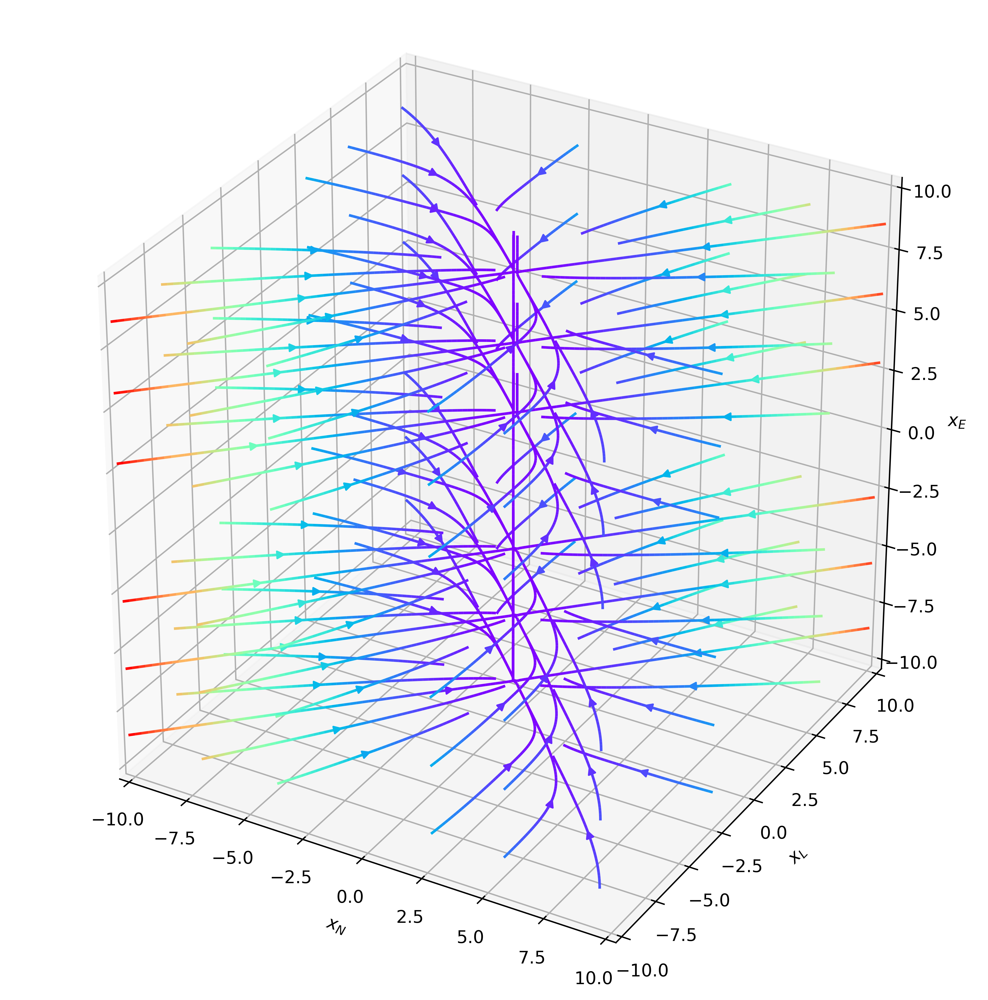

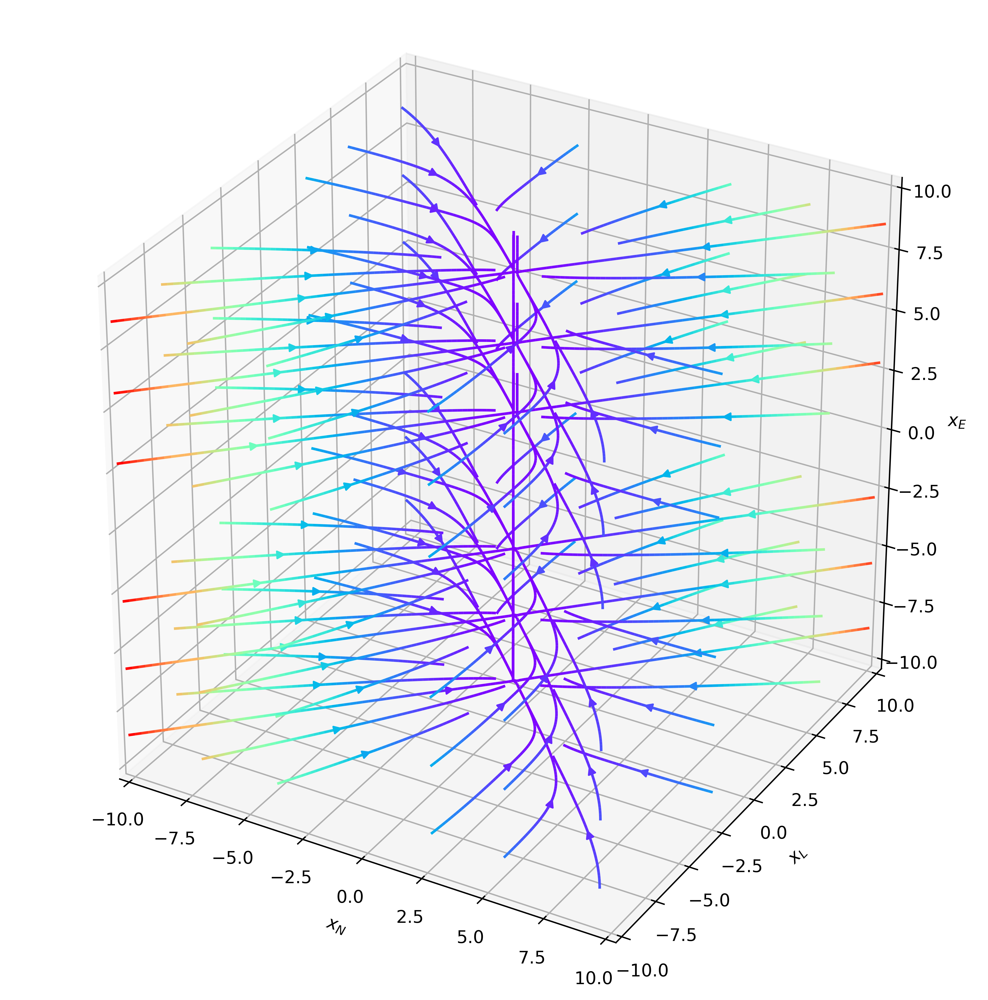

In [9]:
psis = [-2, 0, 2] 

alpha=1.5e-4
k = 2.1e4
T_E = 5.554
T_L = 3.018
T_N = 0.175
d = 1e-2
beta = 8e-4
S_star = 3
gamma = 0.5
x_T=0.5 

a_N =(k*alpha*(T_N - T_E))/d
a_L = (k*alpha*(T_L - T_E))/d
b = (k*beta*S_star)/d

for psi in psis:
    def three_box_final_3D(x_N, x_L, psi=psi, a_N=a_N, a_L=a_L, b=b, gamma=gamma):

        dx_N = gamma*psi+(1-x_N)+abs(a_N+b*(2*x_N-x_T+x_L))*(x_T-x_L-2*x_N)
        dx_L = (1-gamma)*psi+(1-x_L)+abs(a_L+b*(2*x_L-x_T+x_N))*(x_T-x_N-2*x_L)
        dx_E = x_T - x_N - x_L
        
        return dx_N, dx_L, dx_E

    plt.rcParams['figure.figsize'] = [10, 10]
    plt.rcParams['figure.dpi'] = 600

    three_box_3D_portrait = PhasePortrait3D(three_box_final_3D, [-10,10], MeshDim=8, Title=r'', xlabel=r"$x_N$", ylabel=r"$x_L$", zlabel=r"$x_E$")
    fig, ax = three_box_3D_portrait.plot()
    plt.show()
    # save figure
    # fig.savefig(f"gif1/kd_{kd}.png")

### With constant flow rate

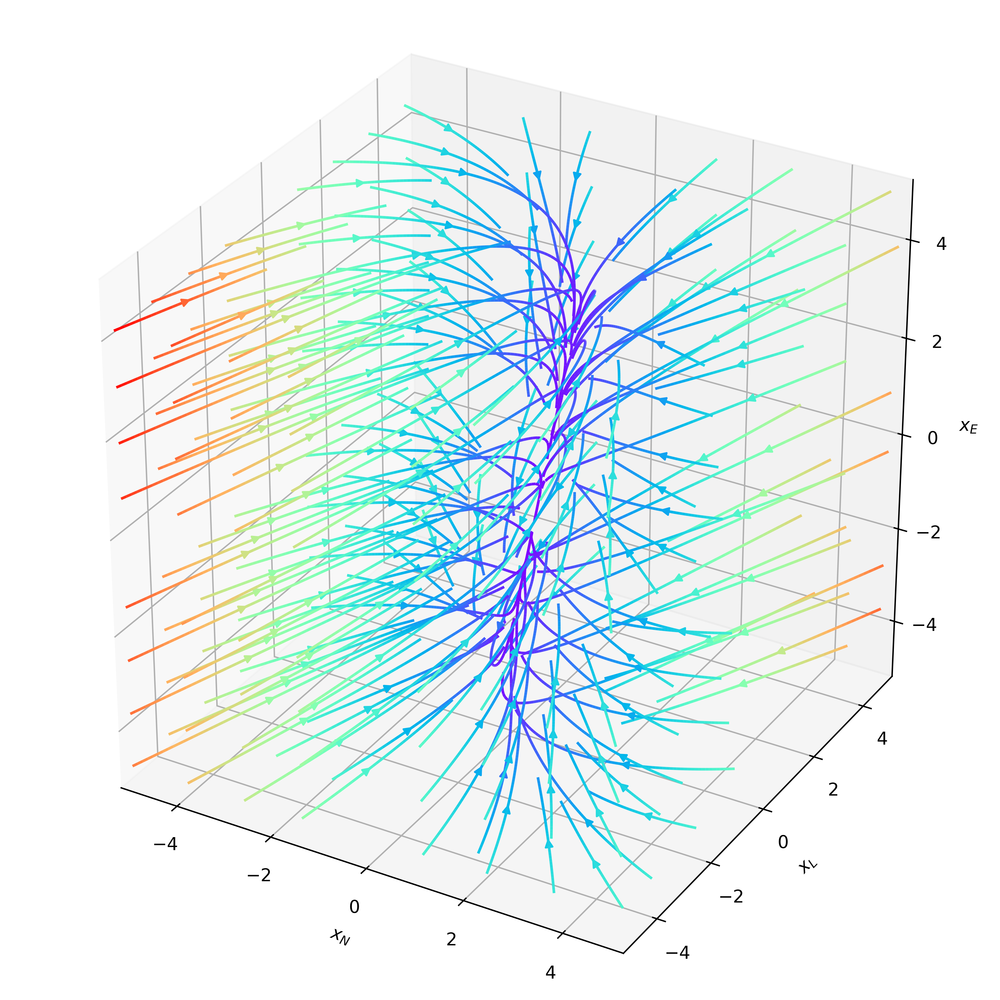

In [3]:
psis = [10] 

alpha=1.5e-4
k = 2.1e4
T_E = 5.554
T_L = 3.018
T_N = 0.175
d = 1e-2
beta = 8e-4
S_star = 3
gamma = 0.5 # symmetrical case
x_T=0.5 


a_N =(k*alpha*(T_N - T_E))/d
a_L = (k*alpha*(T_L - T_E))/d
b = (k*beta*S_star)/d



for psi in psis:
    def three_box_final_3D(x_N, x_L, psi=psi, a_N=a_N, a_L=a_L, b=b, gamma=gamma):

        # abs(a_N+b*(2*x_N-x_T+x_L))
        # abs(a_L+b*(2*x_L-x_T+x_N))

        dx_N = gamma*psi+(1-x_N)+(x_T-x_L-2*x_N)
        dx_L = (1-gamma)*psi+(1-x_L)+(x_T-x_N-2*x_L)
        dx_E = x_T - x_N - x_L
        
        return dx_N, dx_L, dx_E

    plt.rcParams['figure.figsize'] = [10, 10]
    plt.rcParams['figure.dpi'] = 600

    three_box_3D_portrait = PhasePortrait3D(three_box_final_3D, [-5,5], MeshDim=10, Title=r'', xlabel=r"$x_N$", ylabel=r"$x_L$", zlabel=r"$x_E$")
    fig, ax = three_box_3D_portrait.plot()
    plt.show()
    # save figure
    # fig.savefig(f"gif1/kd_{kd}.png")

### Constant Flow rate in 2D

-1694.385 -798.8400000000001 5040.000000000001


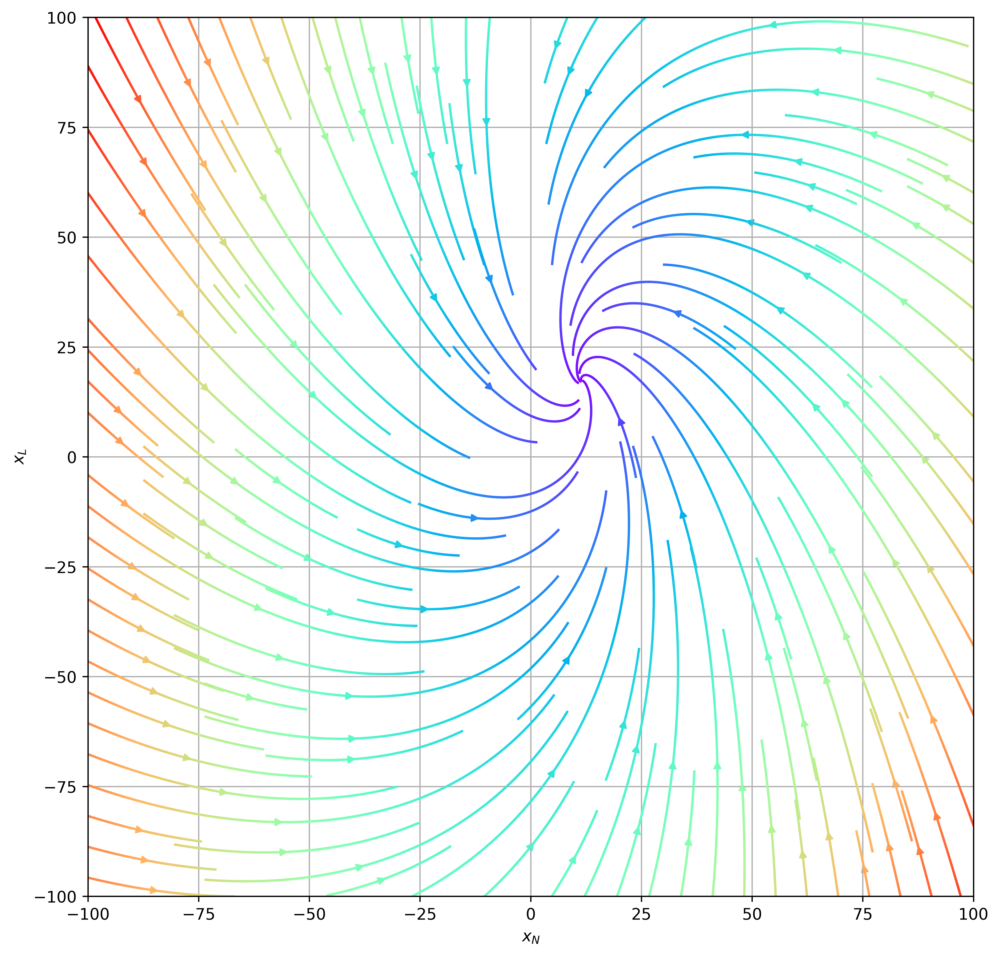

In [47]:
psi = 100

alpha=1.5e-4
k = 2.1e4
T_E = 5.554
T_L = 3.018
T_N = 0.175
d = 1e-2
beta = 8e-4
S_star = 3
gammas = [0.5] 
x_T=0.5 


a_N =(k*alpha*(T_N - T_E))/d
a_L = (k*alpha*(T_L - T_E))/d
b = (k*beta*S_star)/d


print(a_N, a_L, b)


for gamma in gammas:
    def three_box_final_3D(x_N, x_L, psi=psi, a_N=a_N, a_L=a_L, b=b, gamma=gamma):

        # F_N = a_N+b*(2*x_N-x_T+x_L)
        # F_L = a_L+b*(2*x_L-x_T+x_N)
        F_N = 1
        F_L = 1

        x_N = gamma*psi+(1-x_N)+abs(F_N)*(x_T-x_L-2*x_N)
        x_L = (1-gamma)*psi+(1-x_L)+abs(F_L)*(x_T-x_N-2*x_L)
        
        return x_N, x_L

    plt.rcParams['figure.figsize'] = [10, 10]
    plt.rcParams['figure.dpi'] = 600

    three_box_3D_portrait = PhasePortrait2D(three_box_final_3D, [-100,100], MeshDim=30, Title=r'', xlabel=r"$x_N$", ylabel=r"$x_L$")
    fig, ax = three_box_3D_portrait.plot()
    plt.show()
    # save figure
    fig.savefig(f"gif1/gamma_2D_{gamma}.png")